# Streak simultaneous measurement 

Laser on the streak, splitted to the photodiode. 

Reduced ROI to have the same profile max intensity on the streak camera profile. 

In [1]:
%run ../../PhD-utils/AWAKE-toolbox.py

import matplotlib.pyplot as plt
%matplotlib inline

import glob
import scipy.io as sio

Version 0.1
Please report bugs to eugenio.senes@cern.ch
Use at your own risk.


In [2]:
print_pdf = True

In [3]:
scopePath = './Photodiode-on-LeCroy18GHz'
imPath = './LaserOnStreak+photodiode/Gain40_slit20um_1ns_lecroy_corrected'

In [303]:
# wanna load ?
data = pnd.read_pickle('Lecroy-dataFrame-reducedROI.pkl')

In [6]:
# Init the dataframe
data = pnd.DataFrame([],columns=['scope_t','scope_V','scope_t_sampling'])

# Scope traces

## Load

In [7]:
scopePathList = sorted(glob.glob(scopePath+'/*.txt'))

In [8]:
name = '0'
for k, label in enumerate(scopePathList):
    name = str(k)
    data.loc[name] = load_data_LeCroy(scopePathList[k])


In [9]:
# label dark shots
dark_thr_scope = 0.4
data['scope_dark'] = data['scope_V'].apply(lambda x: np.max(x)<dark_thr_scope)

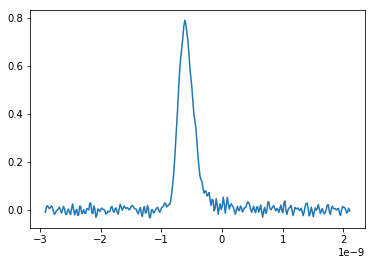

In [10]:
ll = 3
plt.plot(data["scope_t"].iloc[ll], data["scope_V"].iloc[ll],'-')

## FFT

In [11]:
# add columns to dataframe
data['scope_f'] = [np.empty(0,dtype=float)]*len(data)
data['scope_dB'] = [np.empty(0,dtype=float)]*len(data)

In [12]:
# do the fft
for k in data.index:
    print(k)
    data["scope_f"].loc[k], data["scope_dB"].loc[k]  = doFFT(data["scope_t"].loc[k], data["scope_V"].loc[k])

0
1
2
3
4


/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:189: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279


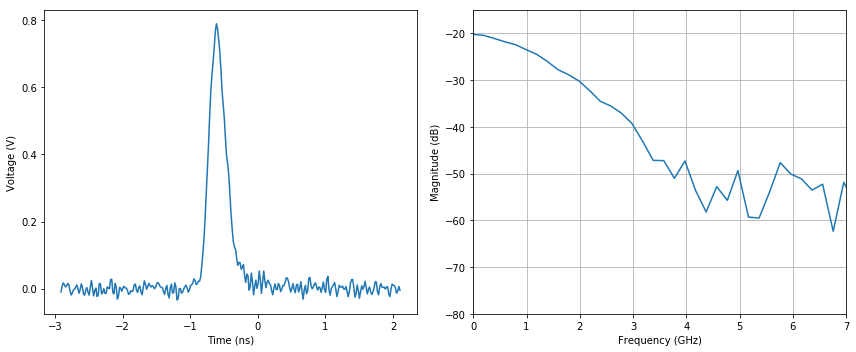

In [13]:
ll = 3

fig, ax = plt.subplots(1,2, figsize=(12,5))

ax[0].plot(1e9*data["scope_t"].iloc[ll], data["scope_V"].iloc[ll],'-')
ax[0].set_xlabel('Time (ns)')
ax[0].set_ylabel('Voltage (V)')
# ax[0].set_xlim(-1, 0)
# ax[0].plot([-1,0],[np.max(data["scope_V"].iloc[ll])/2., np.max(data["scope_V"].iloc[ll])/2.],'-')
# ax[0].axvline(x=-0.74)
# ax[0].axvline(x=-0.46)


ax[1].plot(1e-9*data["scope_f"].iloc[ll], dB(data["scope_dB"].iloc[ll]),'-')
ax[1].set_xlabel('Frequency (GHz)')
ax[1].set_ylabel('Magnitude (dB)')
ax[1].set_xlim(0,7)
ax[1].set_ylim(-80,-15)
ax[1].grid()

plt.tight_layout()

# Streak images

## Load

In [14]:
# Load correct streak timescale
y_streak_lin = 1e-12*sio.loadmat('../Streak-camera-correction/timeAxis1ns.mat')['y_lin'].flatten()

In [15]:
streakPathList = sorted(glob.glob(imPath+'/*.csv'))

In [16]:
data_aux = pnd.DataFrame([],columns=['Streak_image','Streak_t_scale'])

name = '0'
for k, label in enumerate(streakPathList):
    print(k)
    name = str(k)
    data_aux.loc[label] = (np.genfromtxt(streakPathList[k], delimiter=','), y_streak_lin)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

## Extract the profile

In [17]:
data_aux['Streak_profile'] = data_aux['Streak_image'].apply(lambda x: np.sum(x, axis=1))

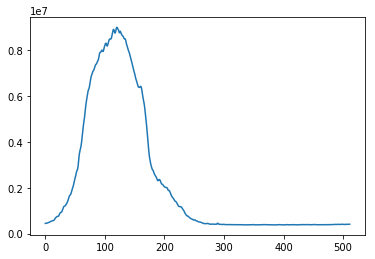

In [18]:
k=22
prof = np.sum(data_aux['Streak_image'].iloc[k], axis=1)
plt.plot(prof)

## Check dark frames

In [19]:
# set a threshold in a region with no hot pixels
img_thr = 30e6
data_aux['Streak_dark'] = data_aux['Streak_image'].apply(lambda x: np.sum(np.sum(x, axis=0)[200:300]) < img_thr )

# Match the acquisition

Drop the first 5 scope acquisition and the first 13 streak ones.

In [20]:
# drop the heads
data = data.drop(['0','1','2','3','4'])
data_aux = data_aux.drop(data_aux.index[:14])

In [21]:
print(data.shape)
print(data_aux.shape)

(491, 6)
(486, 4)


In [22]:
# ok so cut also the tail
data = data.drop(data.index[-5:])

In [23]:
data_aux.columns

Index(['Streak_image', 'Streak_t_scale', 'Streak_profile', 'Streak_dark'], dtype='object')

In [24]:
# and merge
data['Streak_image'] = [np.empty((512, 672), dtype=float)]*len(data)
data['Streak_t_scale'] = [np.empty(0, dtype=float)]*len(data)
data['Streak_profile'] = [np.empty(0, dtype=float)]*len(data)
data['Streak_dark'] = False


for k in range(len(data.index)):
    print(k)
    data['Streak_image'].iloc[k] = data_aux['Streak_image'].iloc[k]
    data['Streak_t_scale'].iloc[k] = data_aux['Streak_t_scale'].iloc[k]
    data['Streak_profile'].iloc[k] = data_aux['Streak_profile'].iloc[k]
    data['Streak_dark'].iloc[k] = data_aux['Streak_dark'].iloc[k]


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

# FWHM analysis: streak jitter

In [25]:
# find the centre peak using the FWHM algorithm. Skip dark frames.
def find_centre_FWHM(x, y, flag):
    if flag == False:
        return find_FWHM(x, y)[1][0]
    else:
        return np.nan

data['Streak_centre'] = np.nan
data['Streak_centre'] = data.apply(lambda x: find_centre_FWHM(x['Streak_t_scale'], x['Streak_profile'], x['Streak_dark']), axis=1)

# align all to say 0.55 ns
dt_streak = data['Streak_t_scale'].iloc[0][1]-data['Streak_t_scale'].iloc[0][0]
centre_target = dt_streak*0.25e3
data['Streak_jitter'] = data['Streak_centre'] - centre_target
# new time axis, jitter free
data['Streak_t_align'] = data['Streak_t_scale'] - data['Streak_jitter'] 

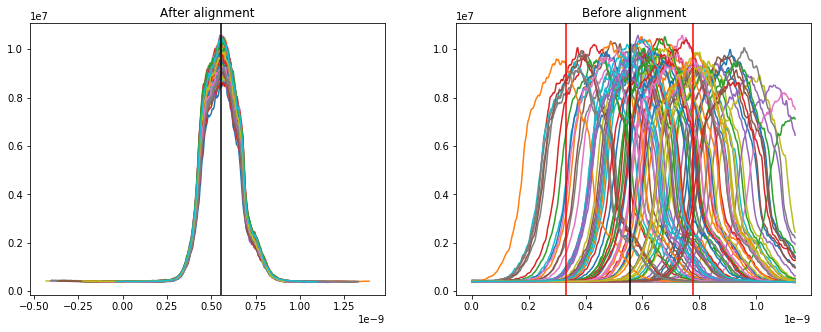

In [26]:
fig, ax = plt.subplots(1,2, figsize=(14,5))

for k in 12+np.array(range(80)):
    xx = data['Streak_t_align'].iloc[k]
    yy = data['Streak_profile'].iloc[k]
    ax[0].plot(xx, yy)
        
    xx1 = data['Streak_t_scale'].iloc[k]
    ax[1].plot(xx1, yy)



ax[0].axvline(x=centre_target, color='k')
ax[1].axvline(x=centre_target, color='k')
ax[0].set_title('After alignment')
ax[1].set_title('Before alignment')

ax[1].axvline(x=centre_target+dt_streak*0.10e3, color='r')
ax[1].axvline(x=centre_target-dt_streak*0.10e3, color='r')



0.17373122870301244


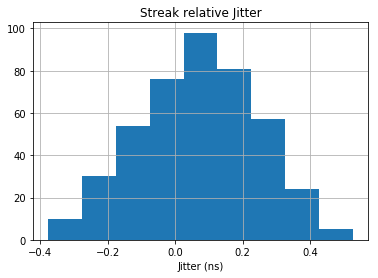

In [27]:
binwidth = 0.1
dd_hist = 1e9*data['Streak_jitter']
plt.hist(dd_hist, bins=np.arange(np.min(dd_hist), np.max(dd_hist) + binwidth, binwidth))
plt.xlabel('Jitter (ns)')
plt.grid()
plt.title('Streak relative Jitter')
print(np.std(dd_hist))

In [28]:
Jitter_thr = dt_streak*0.095e3
data["Streak_jitter_ok"] = np.logical_and(data['Streak_jitter'] < Jitter_thr, data['Streak_jitter'] > -Jitter_thr)

# New streak profile in a window from the center

In [36]:
from math import isclose

In [153]:
# find the centre of the image from the FWHM center peak
data['Streak_centre_bin'] = np.nan

for k in data.index:
    flags = [isclose(data['Streak_centre'].loc[k], elem, abs_tol=0.5*dt_streak) for elem in data['Streak_t_scale'].loc[k]]
    idx = np.where(flags)
    if len(idx[0]) > 0:
        data['Streak_centre_bin'].loc[k] = np.int(np.asscalar(idx[0]))
    else:
        data['Streak_centre_bin'].loc[k] = np.nan

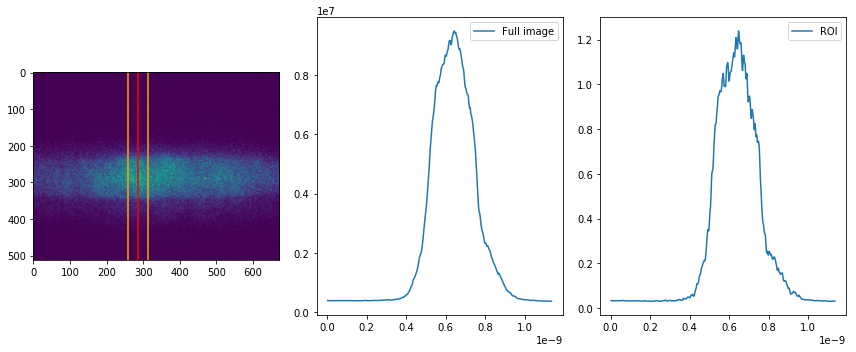

In [306]:
ll=100

wind_size = 27

fig, ax = plt.subplots(1, 3,figsize=(12,5))
im_c = data['Streak_image'].iloc[ll]
ax[0].imshow(im_c)
ax[0].axvline(x=data['Streak_centre_bin'].iloc[ll], color='r')
ax[0].axvline(x=data['Streak_centre_bin'].iloc[ll]+wind_size, color='orange')
ax[0].axvline(x=data['Streak_centre_bin'].iloc[ll]-wind_size, color='orange')

ax[1].plot(data['Streak_t_scale'].iloc[ll], data['Streak_profile'].iloc[ll], label='Full image')
ax[1].legend()
new_profile = np.sum(im_c[:, np.int(data['Streak_centre_bin'].iloc[ll]-wind_size):np.int(data['Streak_centre_bin'].iloc[ll]+wind_size)], axis=1)
ax[2].plot(data['Streak_t_scale'].iloc[ll], 1e-6*new_profile, label='ROI')
ax[2].legend()


fig.tight_layout()

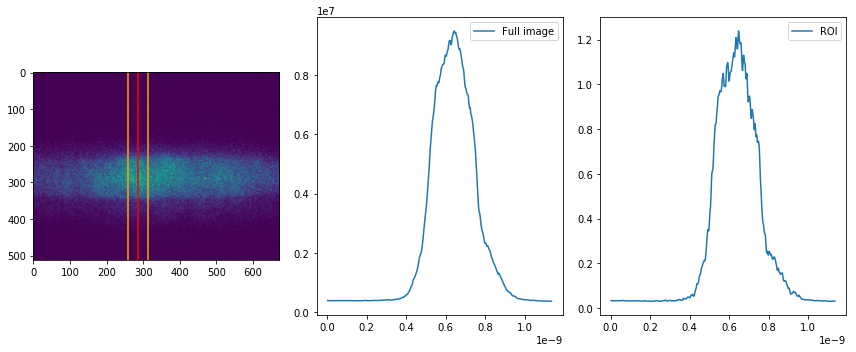

In [307]:
ll=100

wind_size = 27

fig, ax = plt.subplots(1, 3,figsize=(12,5))
im_c = data['Streak_image'].iloc[ll]
ax[0].imshow(im_c)
ax[0].axvline(x=data['Streak_centre_bin'].iloc[ll], color='r')
ax[0].axvline(x=data['Streak_centre_bin'].iloc[ll]+wind_size, color='orange')
ax[0].axvline(x=data['Streak_centre_bin'].iloc[ll]-wind_size, color='orange')

ax[1].plot(data['Streak_t_scale'].iloc[ll], data['Streak_profile'].iloc[ll], label='Full image')
ax[1].legend()
new_profile = np.sum(im_c[:, np.int(data['Streak_centre_bin'].iloc[ll]-wind_size):np.int(data['Streak_centre_bin'].iloc[ll]+wind_size)], axis=1)
ax[2].plot(data['Streak_t_scale'].iloc[ll], 1e-6*new_profile, label='ROI')
ax[2].legend()


fig.tight_layout()

In [276]:
wind_size = 25

data['Streak_profile_ROI'] = [np.empty(0,dtype=float)]*len(data)
for ind in data.index:
    try:
        data['Streak_profile_ROI'].loc[ind] = np.sum(data['Streak_image'].loc[ind][:, np.int(data['Streak_centre_bin'].loc[ind]-wind_size):np.int(data['Streak_centre_bin'].loc[ind]+wind_size)], axis=1)
    except ValueError:
        data['Streak_profile_ROI'].loc[ind] = np.nan*np.empty(512,dtype=float)


# Ok now we have a similar profile to the beam based measurement

## Now, FFT !

In [278]:
# add columns to dataframe
data['Streak_f'] = [np.empty(0,dtype=float)]*len(data)
data['Streak_dB'] = [np.empty(0,dtype=float)]*len(data)

In [279]:
# do the fft
for k in data.index:
    print(k)
    data["Streak_f"].loc[k], data["Streak_dB"].loc[k]  = doFFT(data["Streak_t_scale"].loc[k], data["Streak_profile_ROI"].loc[k])
    

5


/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:189: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
28

In [280]:
# salva che non si sa mai 
data.to_pickle('Lecroy-dataFrame-reducedROI.pkl')

In [283]:
data = data.drop(columns=['Streak_profile'])

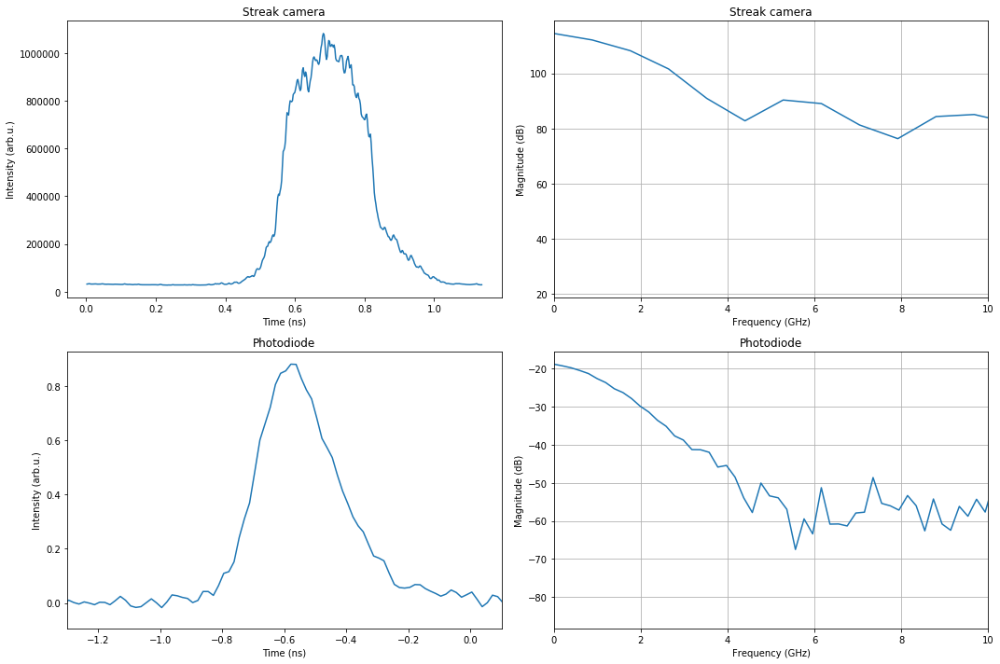

In [331]:
ll = 13

fig, ax = plt.subplots(2,2, figsize=(15,10))

ax[0,0].plot(1e9*data["Streak_t_scale"].iloc[ll], data["Streak_profile_ROI"].iloc[ll],'-')
ax[0,0].set_xlabel('Time (ns)')
ax[0,0].set_ylabel('Intensity (arb.u.)')
ax[0,0].set_title("Streak camera")

ax[0,1].plot(1e-9*data["Streak_f"].iloc[ll], dB(data["Streak_dB"].iloc[ll]),'-')
ax[0,1].set_xlabel('Frequency (GHz)')
ax[0,1].set_ylabel('Magnitude (dB)')
ax[0,1].set_xlim(0,10)
ax[0,1].set_title("Streak camera")
# ax[0,1].set_ylim(80,140)
ax[0,1].grid()


ax[1,0].plot(1e9*data["scope_t"].iloc[ll], data["scope_V"].iloc[ll],'-')
ax[1,0].set_xlabel('Time (ns)')
ax[1,0].set_ylabel('Intensity (arb.u.)')
ax[1,0].set_xlim(-1.3, 0.1)
ax[1,0].set_title("Photodiode")



ax[1,1].plot(1e-9*data["scope_f"].iloc[ll], dB(data["scope_dB"].iloc[ll]),'-')
ax[1,1].set_xlabel('Frequency (GHz)')
ax[1,1].set_ylabel('Magnitude (dB)')
ax[1,1].set_xlim(0,10)
ax[1,1].set_title("Photodiode")
ax[1,1].grid()



plt.tight_layout()

# Create comparison PDF

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


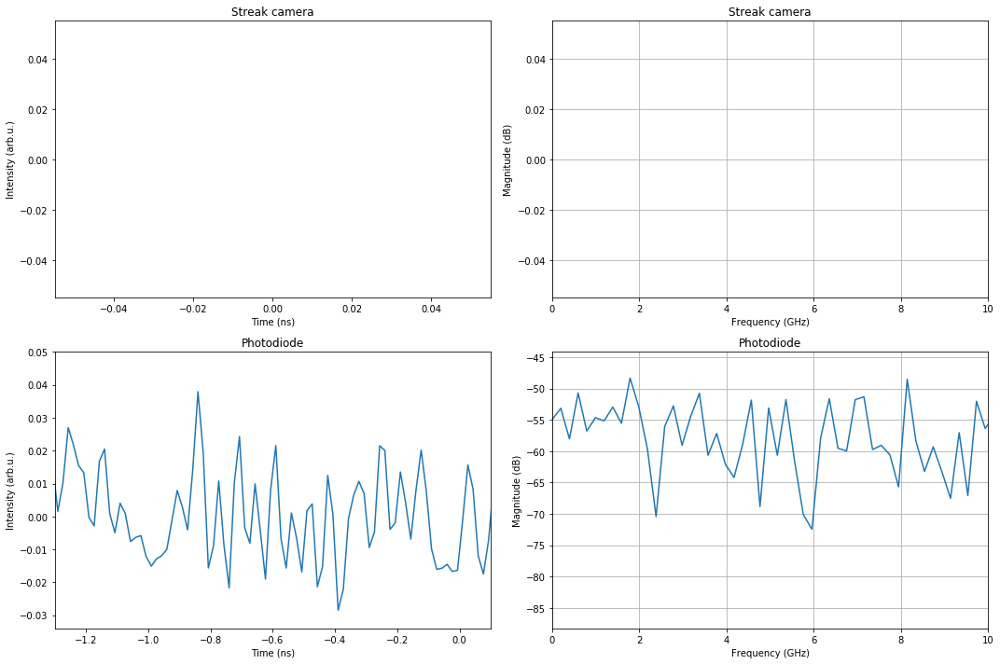

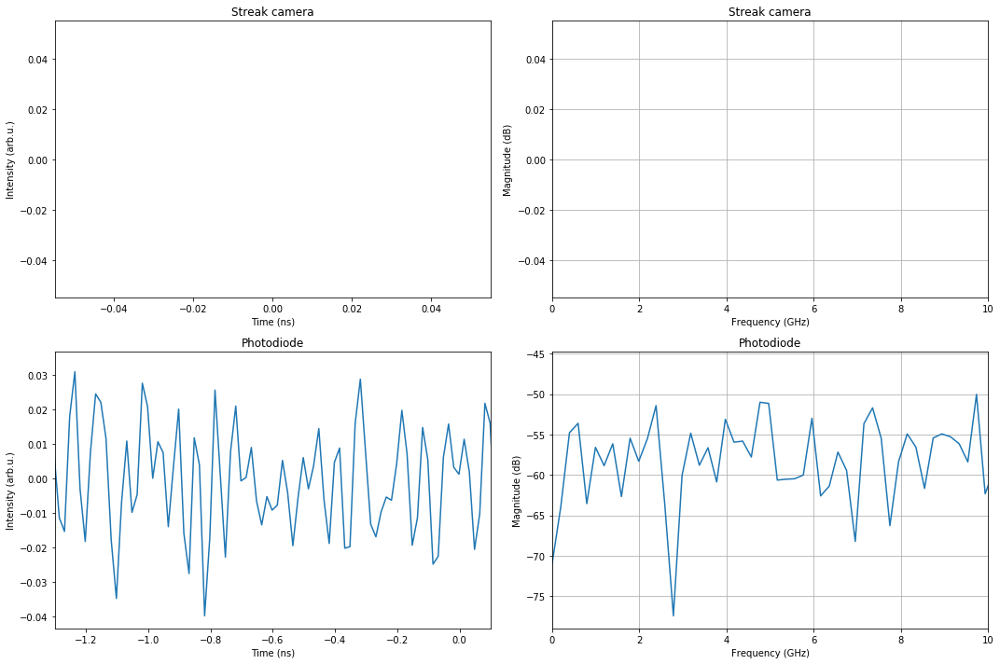

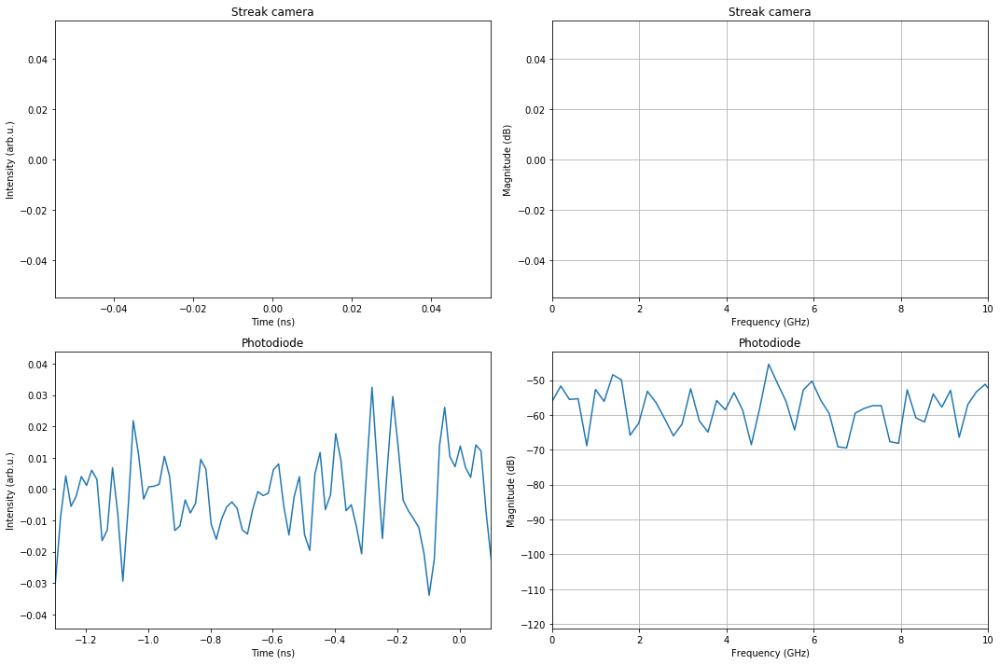

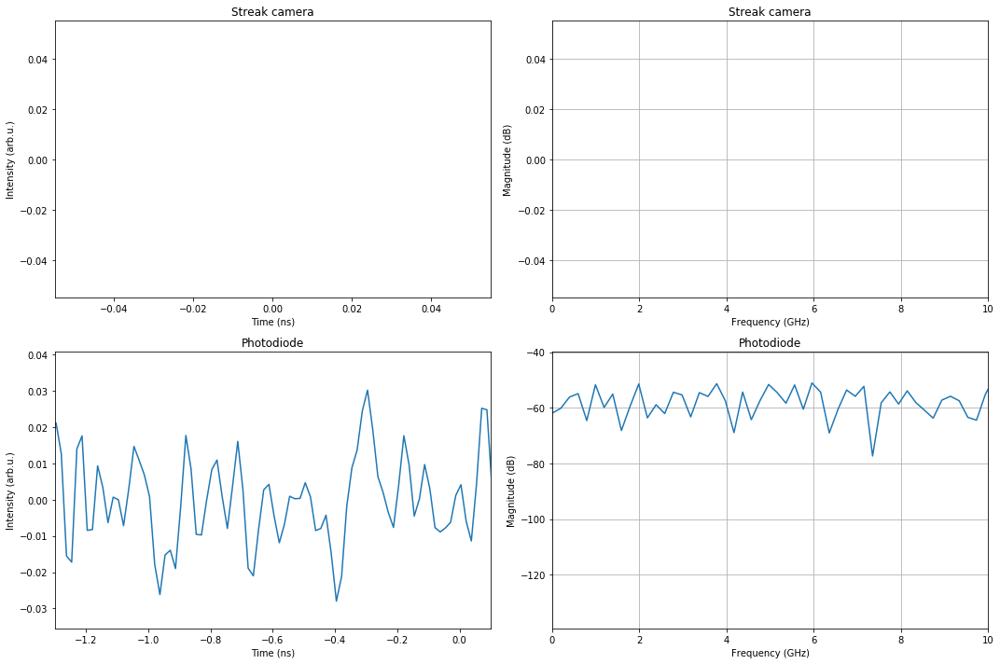

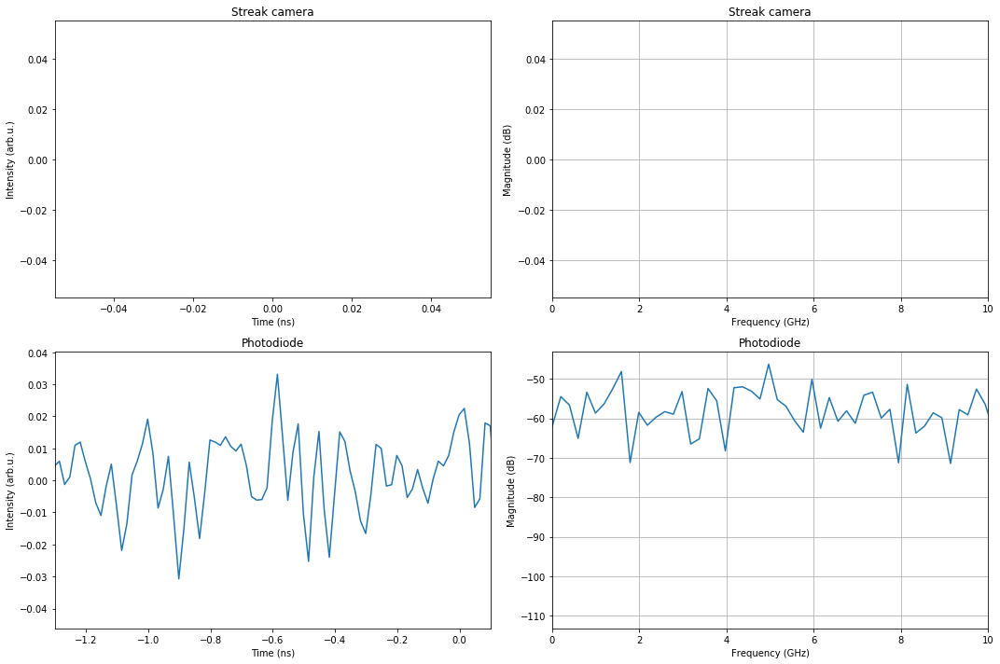

...

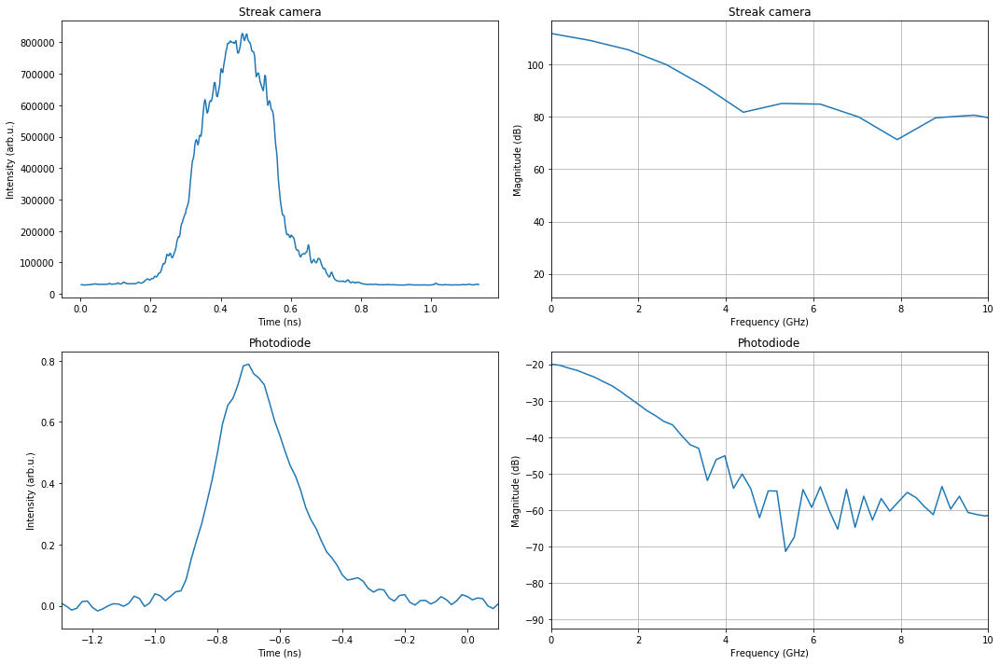

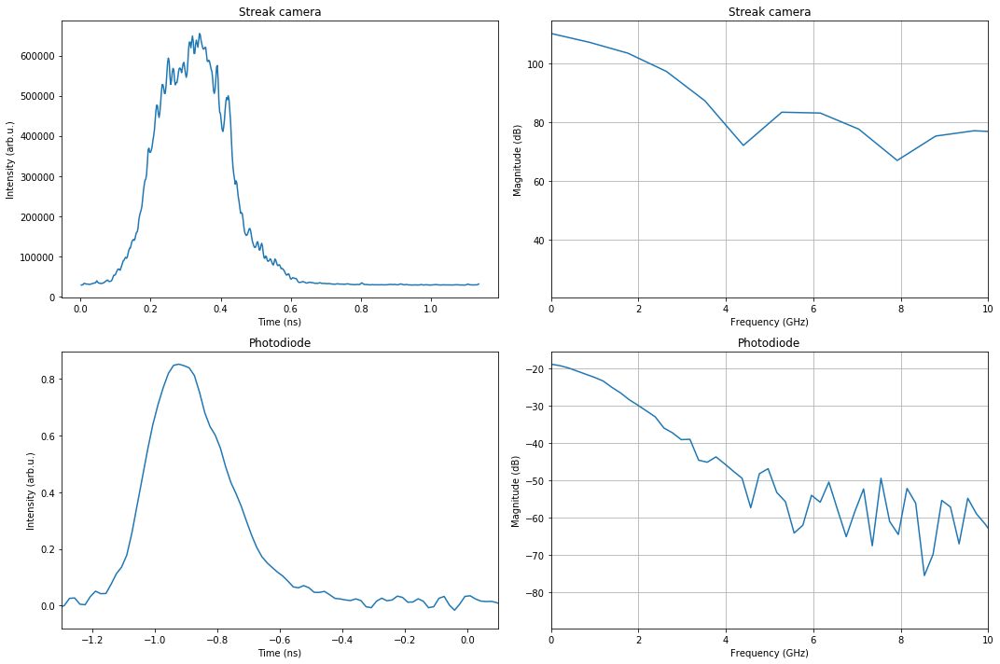

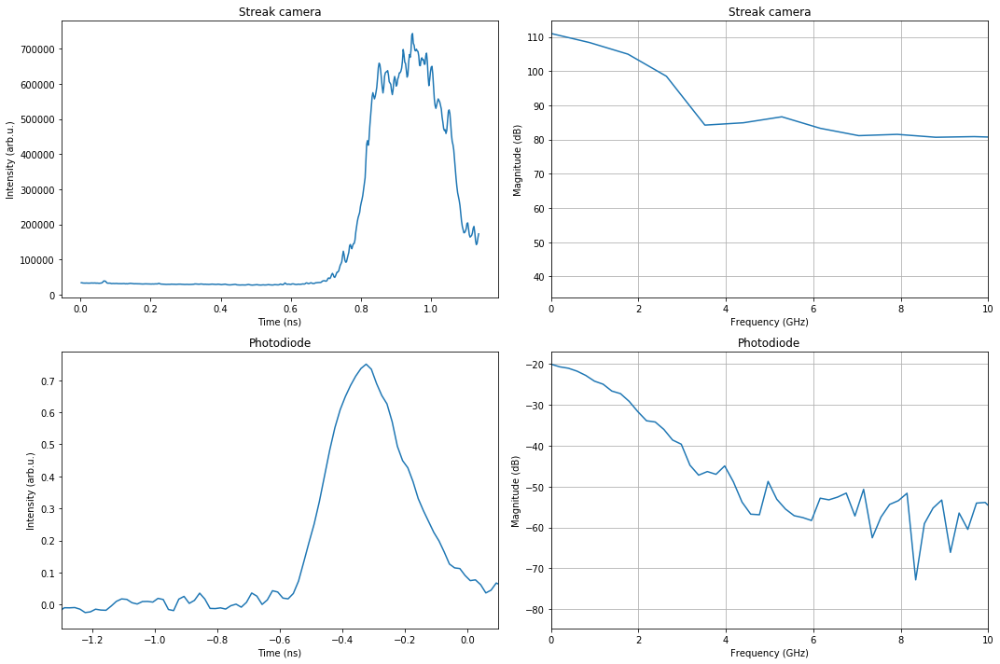

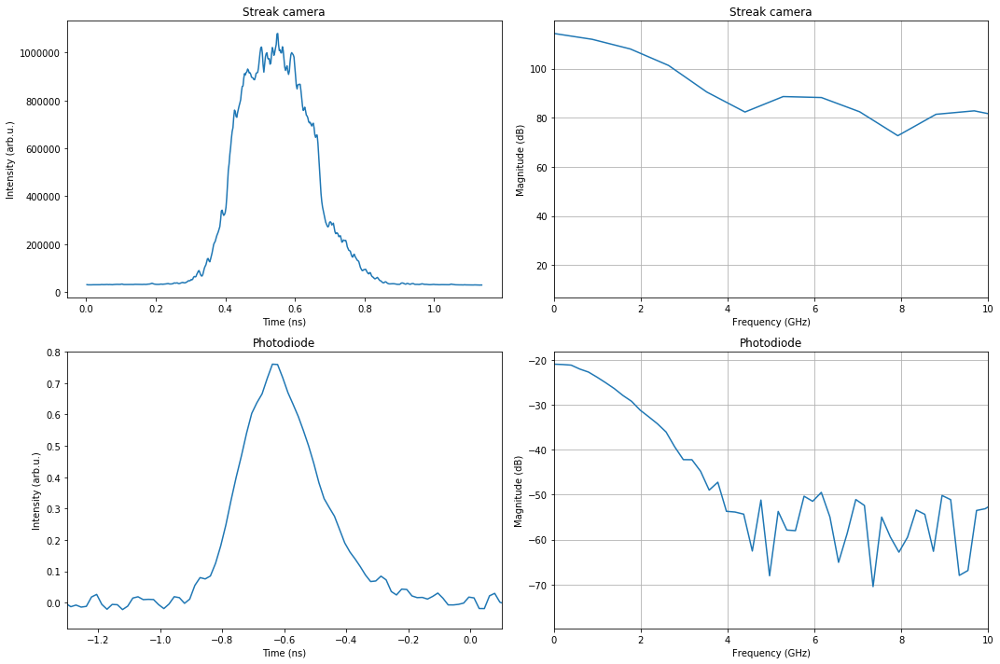

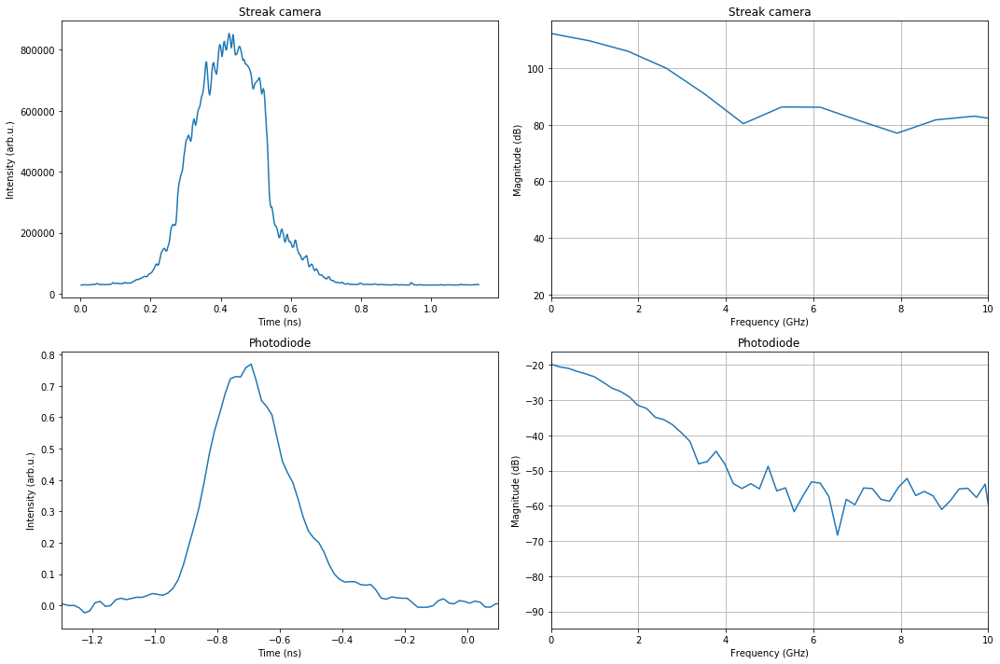

In [287]:
# pdf dump
if print_pdf:
    #init
    from matplotlib.backends.backend_pdf import PdfPages
    pdf_report = PdfPages('LeCroy+streak_ROI.pdf')

    for ll in range(len(data)):
        # Printing
        fig, ax = plt.subplots(2,2, figsize=(15,10))

        ax[0,0].plot(1e9*data["Streak_t_scale"].iloc[ll], data["Streak_profile_ROI"].iloc[ll],'-')
        ax[0,0].set_xlabel('Time (ns)')
        ax[0,0].set_ylabel('Intensity (arb.u.)')
        ax[0,0].set_title("Streak camera")

        ax[0,1].plot(1e-9*data["Streak_f"].iloc[ll], dB(data["Streak_dB"].iloc[ll]),'-')
        ax[0,1].set_xlabel('Frequency (GHz)')
        ax[0,1].set_ylabel('Magnitude (dB)')
        ax[0,1].set_xlim(0,10)
        ax[0,1].set_title("Streak camera")
        # ax[0,1].set_ylim(80,140)
        ax[0,1].grid()


        ax[1,0].plot(1e9*data["scope_t"].iloc[ll], data["scope_V"].iloc[ll],'-')
        ax[1,0].set_xlabel('Time (ns)')
        ax[1,0].set_ylabel('Intensity (arb.u.)')
        ax[1,0].set_xlim(-1.3, 0.1)
        ax[1,0].set_title("Photodiode")



        ax[1,1].plot(1e-9*data["scope_f"].iloc[ll], dB(data["scope_dB"].iloc[ll]),'-')
        ax[1,1].set_xlabel('Frequency (GHz)')
        ax[1,1].set_ylabel('Magnitude (dB)')
        ax[1,1].set_xlim(0,10)
        ax[1,1].set_title("Photodiode")
        ax[1,1].grid()

        fig.tight_layout()

        ### ADD PDF PAGE
        pdf_report.savefig(fig)
        del(fig)

    pdf_report.close()


## Work out the Jitter for the scope

In [334]:
# find the centre peak using the FWHM algorithm. Skip dark frames.
data['scope_centre'] = np.nan
data['scope_centre'] = data.apply(lambda x: find_centre_FWHM(x['scope_t'], x['scope_V'], x['scope_dark']), axis=1)

# align all to say 0.5 ns
centre_target = -1.*data['scope_t_sampling'].iloc[0]*0.4e2
data['scope_jitter'] = data['scope_centre'] - centre_target
# new time axis, jitter free
data['scope_t_align'] = data['scope_t'] - data['scope_jitter'] 

Text(0.5, 1.0, 'Before alignment')

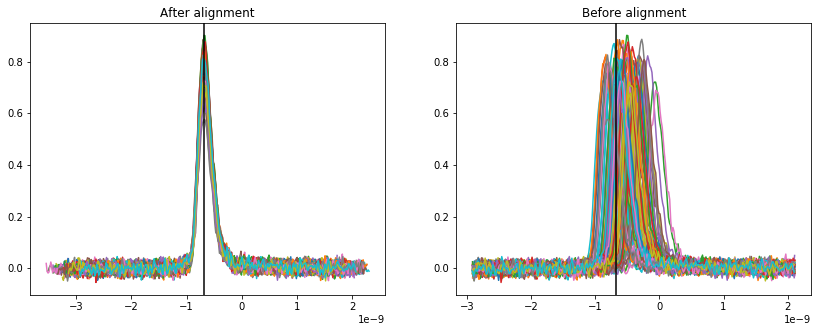

In [335]:
fig, ax = plt.subplots(1,2, figsize=(14,5))

for k in 12+np.array(range(80)):
    xx = data['scope_t_align'].iloc[k]
    yy = data['scope_V'].iloc[k]
    ax[0].plot(xx, yy)
        
    xx1 = data['scope_t'].iloc[k]
    ax[1].plot(xx1, yy)



ax[0].axvline(x=-0.68e-9, color='k')
ax[1].axvline(x=-0.68e-9, color='k')
ax[0].set_title('After alignment')
ax[1].set_title('Before alignment')


0.17154096039186736


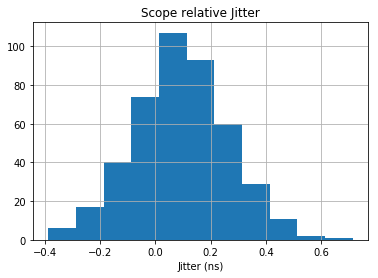

In [336]:
binwidth = 0.1
dd_hist = 1e9*data['scope_jitter']
plt.hist(dd_hist, bins=np.arange(np.min(dd_hist), np.max(dd_hist) + binwidth, binwidth))
plt.xlabel('Jitter (ns)')
plt.grid()
plt.title('Scope relative Jitter')
print(np.std(dd_hist))

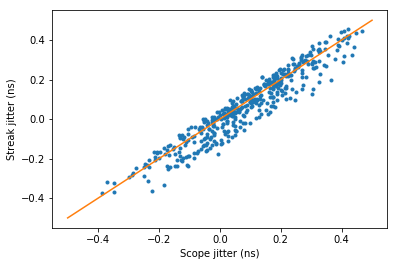

In [337]:
plt.plot(1e9*data['scope_jitter'], 1e9*data['Streak_jitter'], '.')
plt.xlabel('Scope jitter (ns)')
plt.ylabel('Streak jitter (ns)')
plt.plot([-0.5,0.5],[-0.5, 0.5])